In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import wandb

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
from IPython.display import Image

Random Seed:  999


In [2]:
# Дирректория с изображениями
dataroot = "/kaggle/input/celeba-dataset/img_align_celeba"

# Количество воркеров для сборки датасета
workers = 2

# Размер батча
batch_size = 128*2

# Размер входа сети для изображений. Все изображения ресайзятся к нему
image_size = 64

# Количество каналов цвета
nc = 3

# Размер латентного вектора (размерность латентного пространства)
nz = 100

# Size of feature maps in generator
ngf = 64

# Рамер карты признаков для генератора
ndf = 64

# Кол-во эпох
num_epochs = 10

# Лернингрейт
lr = 0.0002

# Параметр для оптимизатора Adam
beta1 = 0.5

# Количество GPU, 0 если считаем на CPU
ngpu = 1

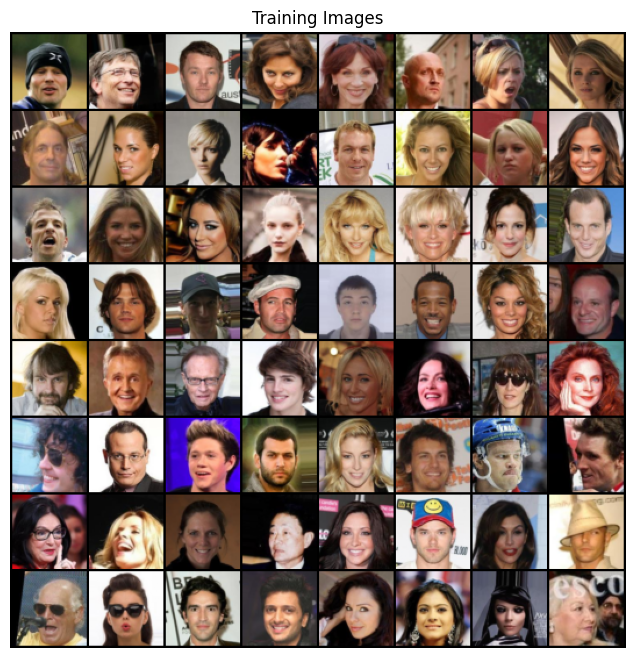

In [3]:
# Для создания датасета используем класс ImageFolder
# Создаем датасет
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Создаем даталоадер
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Выбираем девайс для вычислений
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Нарисуем часть картинок из датасета
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
# кастомная инициализация весов netG или netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [5]:
class CSPup(nn.Module):
    def __init__(self, out_dim):
        super(CSPup, self).__init__()
        self.out_dim = out_dim
        self.a =  nn.ConvTranspose2d(self.out_dim, self.out_dim, 4, 2, 1, bias=False)
        self.b = nn.Sequential(
            nn.Conv2d(self.out_dim, self.out_dim, 1, 1, 0, bias=False),
            nn.BatchNorm2d(self.out_dim),
            nn.LeakyReLU(True),
            nn.ConvTranspose2d(self.out_dim, self.out_dim, 4, 2, 1, bias=False),
            nn.Conv2d(self.out_dim, self.out_dim, 3, 1, 1, bias=False),
            nn.BatchNorm2d(self.out_dim),
            nn.LeakyReLU(True),
            nn.Conv2d(self.out_dim, self.out_dim, 3, 1, 1, bias=False),
        )
    def forward(self, input):
        split = input.size(1)//2
        a, b  = input[:, :split, :, :], input[:, split:, :, :]
        return self.a(a) + self.b(b)

In [6]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.input = nn.ConvTranspose2d(nz, ngf * 16, 4, 1, 0, bias=False)
        self.cspup = nn.Sequential(
            CSPup(ngf * 8),
            CSPup(ngf * 4),
            CSPup(ngf * 2),
            CSPup(ngf),
        )
        self.output = nn.Sequential(
            #nn.ConvTranspose2d(ngf, nc, 2, 2, 0, bias=False),
            nn.Conv2d(ngf, nc, 1, 1, 0, bias=False),
            nn.LeakyReLU(True))
        self.main = nn.Sequential(self.input, self.cspup, self.output)

    def forward(self, input):
        return self.main(input)

In [7]:
# Имплементация дискриминатора

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [8]:
def init_models():
  # Инициализируем генератор
  netG = Generator(ngpu).to(device)

  # Handle multi-gpu if desired
  if (device.type == 'cuda') and (ngpu > 1):
      netG = nn.DataParallel(netG, list(range(ngpu)))

  # Инициализируем веса
  netG.apply(weights_init)

  # инициализируем дискриминатор
  netD = Discriminator(ngpu).to(device)

  # Handle multi-gpu if desired
  if (device.type == 'cuda') and (ngpu > 1):
      netD = nn.DataParallel(netD, list(range(ngpu)))

  # Инициализируем веса
  netD.apply(weights_init)
  return netG, netD

# Train

In [9]:
# Инициализируем модели
netG, netD = init_models()

# Инициализируем лосс
criterion = nn.BCELoss()

# Создаем батч с рандомным шумом для генерации
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Метки для реальных данных и фековых
real_label = 1.
fake_label = 0.

g_lr = 0.0002
d_lr = 0.00002
g_weight_decay = 0
d_weight_decay = 1e-5

# Устанавливаем оптимизаторы для G и D
optimizerD = optim.Adam(netD.parameters(), lr=d_lr, betas=(beta1, 0.999), weight_decay=d_weight_decay)
optimizerG = optim.Adam(netG.parameters(), lr=g_lr, betas=(beta1, 0.999), weight_decay=g_weight_decay)

In [10]:
def train_discriminator(data):
    netD.zero_grad()
    # Для батча
    real_cpu = data[0].to(device)
    b_size = real_cpu.size(0)
    label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
    # Прямой прогон батча из реальных картинок D
    output = netD(real_cpu).view(-1)
    # Считаем лосс на всем батче реальных картинок
    errD_real = criterion(output, label)
    # Вычисляем градиенты для дискриминатора
    errD_real.backward()
    D_x = output.mean().item()

    ## Учим на полном фейковом батче
    # Генерируем батч латентных векторов
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    # Генерируем фековый батч с помощью G
    fake = netG(noise)
    label.fill_(fake_label)
    # Классифицируем фековый батч с помощью D
    output = netD(fake.detach()).view(-1)
    # Вычисляем лосс дискриминатора на фейковом батче
    errD_fake = criterion(output, label)
    # Вычисляем градиент для фейкового батча, он суммируется с предидущим
    errD_fake.backward()
    D_G_z1 = output.mean().item()
    # Вычисляем ошибку на реальном и фековом батчах
    errD = errD_real + errD_fake
    # Обновляем веса D
    optimizerD.step()
    return errD, D_x, D_G_z1

def train_generator():
    noise = torch.randn(batch_size, nz, 1, 1, device=device)
    # Генерируем фековый батч с помощью G
    fake = netG(noise)
    netG.zero_grad()
    label = torch.full((batch_size,), real_label, dtype=torch.float, device=device)  # для генератора фейковые метки есть реальные (0 меняем на 1)
    # Так как мы обновили веса дискриминатора прогоним фековый батч через него еще  раз
    output = netD(fake).view(-1)
    # Вычислим лосс G основываясь на выходе D
    errG = criterion(output, label)
    # Вычислим градиент для G
    errG.backward()
    D_G_z2 = output.mean().item()
    # Обновляем веса G
    optimizerG.step()
    return errG, D_G_z2
    

In [11]:
# Init WandB logging

PROJECT = 'deep-gen-hw2'
from kaggle_secrets import UserSecretsClient
user_secrets = UserSecretsClient()
wandb_key = user_secrets.get_secret("wandb")
config = {'discriminator_lr':d_lr, 'generator_lr':g_lr,
          'epochs':num_epochs,
          'discriminator_weight_decay':d_weight_decay,
          'generator_weight_decay':g_weight_decay,
         'discriminator_optimizer': type(optimizerD),
         'generator_optimizer': type(optimizerG)}
wandb.login(key=wandb_key)
wandb.init(project=PROJECT, config=config)

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: missmarshal22. Use `wandb login --relogin` to force relogin
wandb: wandb version 0.16.4 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade
wandb: Tracking run with wandb version 0.16.3
wandb: Run data is saved locally in /kaggle/working/wandb/run-20240320_090151-367szk5m
wandb: Run `wandb offline` to turn off syncing.
wandb: Syncing run floral-resonance-54
wandb: ⭐️ View project at https://wandb.ai/missmarshal22/deep-gen-hw2
wandb: 🚀 View run at https://wandb.ai/missmarshal22/deep-gen-hw2/runs/367szk5m


In [12]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
errD = torch.inf
errG = torch.inf

print("Starting Training Loop...")
# Для каждой эпохи
for epoch in range(num_epochs):
    # Для каждого батча
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Учим дискриминатор: максимизируем log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        #if errD >= errG:
        errD, D_x, D_G_z1 = train_discriminator(data)

        ############################
        # (2) Учим генератор: максимизируем log(D(G(z)))
        ###########################
        for _ in range(2):
            errG, D_G_z2 = train_generator()


        # Проверим какие картинки рисует генератор
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            examples = vutils.make_grid(fake, padding=2, normalize=True)
            img_list.append(examples)
            wandb.log({'examples':wandb.Image(examples)})

        # Выводим статистику обучения
        if i % 50 == 0:
            wandb.log({'loss_d':errD.item(), 'loss_g':errG.item(), 'dx':D_x, 'dgz1':D_G_z1, 'dgz2':D_G_z2})
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Сохраним лоссы
        G_losses.append(errG.item())
        D_losses.append(errD.item())


        iters += 1
wandb.finish()

Starting Training Loop...
[0/10][0/792]	Loss_D: 1.4505	Loss_G: 0.2489	D(x): 0.5984	D(G(z)): 0.4894 / 0.8549
[0/10][50/792]	Loss_D: 7.4577	Loss_G: 0.0062	D(x): 0.4794	D(G(z)): 0.9948 / 0.9938
[0/10][100/792]	Loss_D: 5.7706	Loss_G: 0.0809	D(x): 0.3801	D(G(z)): 0.9380 / 0.9275
[0/10][150/792]	Loss_D: 5.8322	Loss_G: 0.3112	D(x): 0.1900	D(G(z)): 0.9012 / 0.8144
[0/10][200/792]	Loss_D: 1.9872	Loss_G: 1.5265	D(x): 0.3521	D(G(z)): 0.1373 / 0.2572
[0/10][250/792]	Loss_D: 4.5435	Loss_G: 0.1124	D(x): 0.2000	D(G(z)): 0.8731 / 0.8960
[0/10][300/792]	Loss_D: 2.9068	Loss_G: 0.4872	D(x): 0.3882	D(G(z)): 0.7460 / 0.6227
[0/10][350/792]	Loss_D: 2.7587	Loss_G: 3.7989	D(x): 0.2211	D(G(z)): 0.4283 / 0.0265
[0/10][400/792]	Loss_D: 3.2609	Loss_G: 1.4212	D(x): 0.4065	D(G(z)): 0.8225 / 0.2583
[0/10][450/792]	Loss_D: 2.3554	Loss_G: 1.3804	D(x): 0.3037	D(G(z)): 0.4891 / 0.3327
[0/10][500/792]	Loss_D: 2.3581	Loss_G: 0.2415	D(x): 0.4618	D(G(z)): 0.7195 / 0.7871
[0/10][550/792]	Loss_D: 2.1345	Loss_G: 0.7483	D(x): 0

wandb:                                                                                
wandb: 
wandb: Run history:
wandb:   dgz1 █▇▄▅▃▃▄▄▄▃▂▂▂▃▂▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▁▁▁▁
wandb:   dgz2 █▇▃▄▅▂▅▃▃▃▃▂▂▂▂▁▂▂▂▁▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     dx ▃▁▂▃▅▄▄▄▆▆▆▇▆▅▆▇▆▇▇▇▇▇▇▇████████████████
wandb: loss_d █▅▃▃▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: loss_g ▁▁▂▂▂▃▂▂▂▂▂▃▂▂▃▄▃▃▃▄▃▃▅▄▃█▄▅▆▇▅▅▅▄▄▅▅▄▅▅
wandb: 
wandb: Run summary:
wandb:   dgz1 0.0153
wandb:   dgz2 0.0133
wandb:     dx 0.97041
wandb: loss_d 0.0476
wandb: loss_g 4.34168
wandb: 
wandb: 🚀 View run floral-resonance-54 at: https://wandb.ai/missmarshal22/deep-gen-hw2/runs/367szk5m
wandb: Synced 6 W&B file(s), 17 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20240320_090151-367szk5m/logs


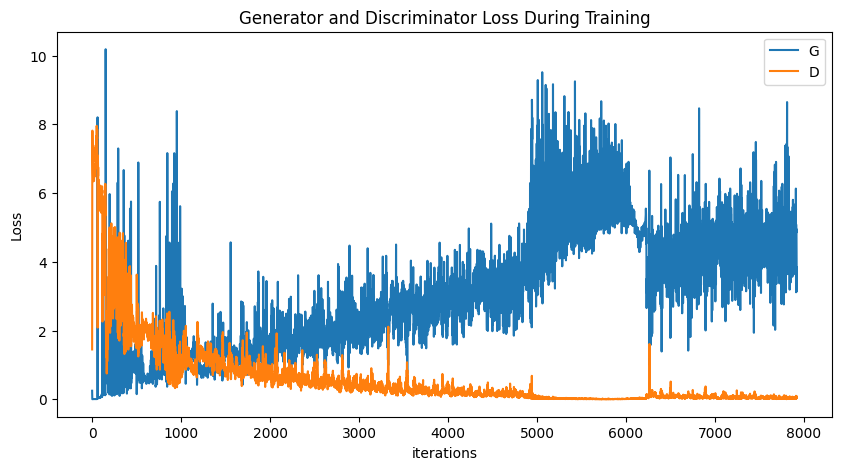

In [13]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

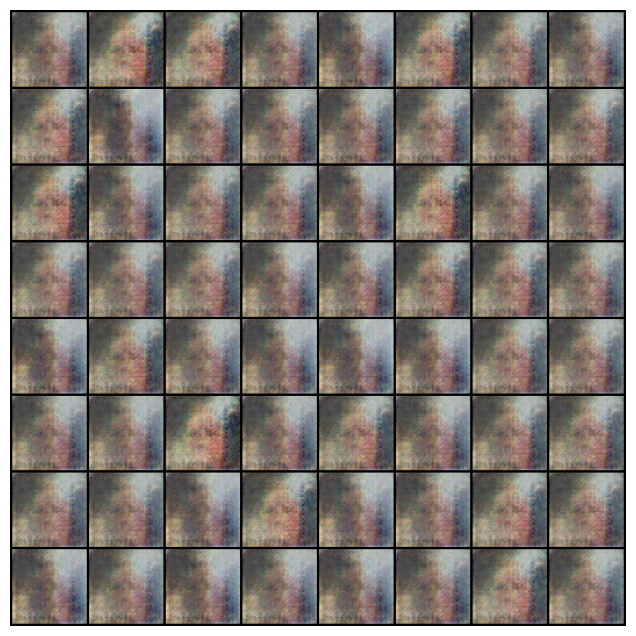

In [14]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())